<h1>Hotel Booking Demand

In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

<h3>Các thư viện kèm theo

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

In [3]:
from sklearn.model_selection import train_test_split
from sklearn.dummy import DummyClassifier
from sklearn import tree
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
# from sklearn import preprocessing
from sklearn.neural_network import MLPClassifier
from sklearn import svm
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier
from datetime import datetime, timedelta
from sklearn.model_selection import ShuffleSplit, cross_val_score, train_test_split, KFold, GridSearchCV

In [4]:
import time

In [5]:
import warnings
warnings.filterwarnings("ignore")

In [6]:
# from google.colab import files

In [7]:
from sklearn.datasets import make_classification
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score

<h3>Đọc dữ liệu bài toán

<li>Nhập dữ liệu đã làm sạch

In [8]:
df = pd.read_csv("duLieuDaXuLy.csv")

<li>Xem 10 dòng dữ liệu đầu tiên của tập dữ liệu

In [9]:
df.head(10)

,Unnamed: 0,hotel,is_canceled,lead_time,arrival_date_month,adults,meal,market_segment,distribution_channel,is_repeated_guest,...,booking_changes,deposit_type,customer_type,adr,total_of_special_requests,total_nights,party_size,is_family,room_difference,status_minus_arrival_date
0,56778,City Hotel,1,2,9,1,BB,Groups,Direct,0,...,0,No Deposit,Transient-Party,3,0,1,1,0,0,2
1,8382,Resort Hotel,1,3,9,1,BB,Online TA,TA/TO,0,...,0,No Deposit,Transient,2,0,2,1,0,0,3
2,61240,City Hotel,1,3,12,1,BB,Online TA,TA/TO,0,...,2,No Deposit,Transient,2,3,4,1,0,0,3
3,76591,City Hotel,1,4,9,1,HB,Groups,TA/TO,0,...,0,Non Refund,Transient,2,0,2,1,0,0,2
4,12737,Resort Hotel,1,1,7,2,BB,Online TA,TA/TO,0,...,1,No Deposit,Transient,4,0,1,2,0,0,1
5,72864,City Hotel,1,4,8,1,BB,Offline TA/TO,TA/TO,0,...,0,No Deposit,Transient,2,0,2,1,0,0,1
6,61550,City Hotel,1,2,12,1,SC,Online TA,TA/TO,0,...,0,No Deposit,Transient,2,1,2,1,0,0,2
7,54984,City Hotel,1,4,8,1,HB,Online TA,TA/TO,0,...,1,No Deposit,Transient,4,2,4,2,1,0,1
8,43977,City Hotel,1,3,9,1,BB,Groups,TA/TO,0,...,0,Non Refund,Transient,4,0,1,1,0,0,3
9,47668,City Hotel,1,1,2,1,BB,Offline TA/TO,TA/TO,0,...,0,No Deposit,Transient-Party,1,0,2,1,0,0,1


<li>Xem xét dữ liệu ban đầu

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 88133 entries, 0 to 88132
Data columns (total 22 columns):
 #   Column                          Non-Null Count  Dtype 
---  ------                          --------------  ----- 
 0   Unnamed: 0                      88133 non-null  int64 
 1   hotel                           88133 non-null  object
 2   is_canceled                     88133 non-null  int64 
 3   lead_time                       88133 non-null  int64 
 4   arrival_date_month              88133 non-null  int64 
 5   adults                          88133 non-null  int64 
 6   meal                            88133 non-null  object
 7   market_segment                  88133 non-null  object
 8   distribution_channel            88133 non-null  object
 9   is_repeated_guest               88133 non-null  int64 
 10  previous_cancellations          88133 non-null  int64 
 11  previous_bookings_not_canceled  88133 non-null  int64 
 12  booking_changes                 88133 non-null

<li>Xóa thuộc tính <strong>Unnamed: 0</strong> trong tập dữ liệu


In [11]:
df = df.drop(["Unnamed: 0"], axis = 1)

<li>Tạo datafframe mới dựa trên tập dữ liệu ban đầu

<h3>Khảo sát độ tương đồng giữa các thuộc tính với nhau bằng công thức Pearson. Những cột nào có giá trị tương đồng cao thì hãy loại bỏ.

<li>Tạo hàm lấy các các thuộc tính có độ tương quan cao

In [12]:
def correlation(dataset, threshold):
    col_corr = set() #Tập hợp tất cả các cột tương quan
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if abs(corr_matrix.iloc[i, j]) > threshold:
                colname = corr_matrix.columns[i]  
                col_corr.add(colname)
    return col_corr

<li>Kết hợp với thư viện biểu diễn đồ thị seaborn để trực quan hóa kết quả bằng đồ thị heatmap.

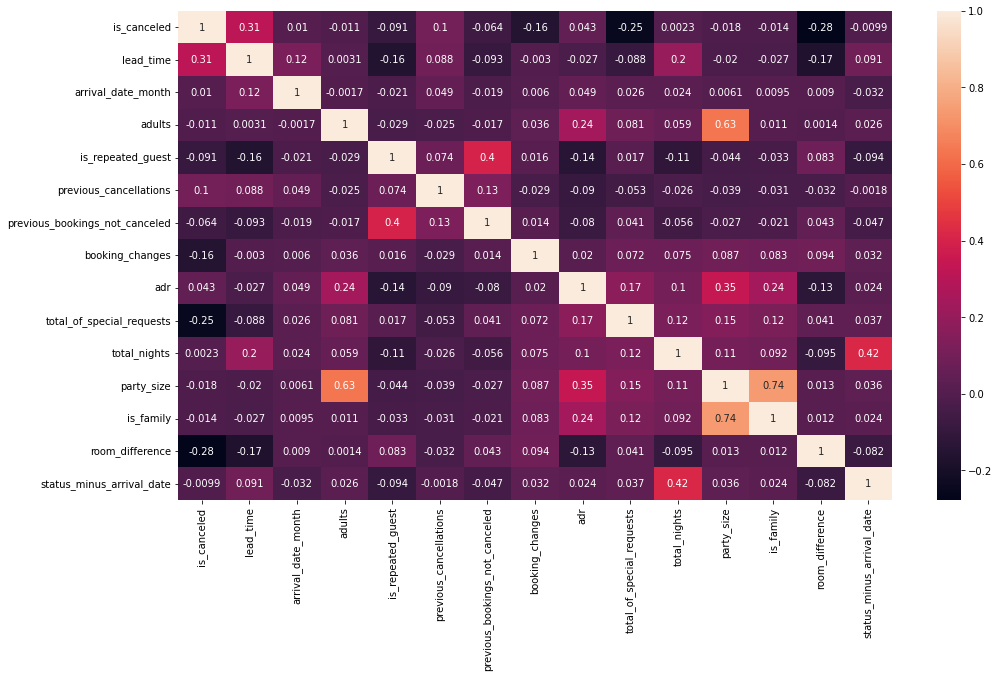

In [13]:
plt.figure(figsize=(16,9))
sns.heatmap(df.corr(method='pearson'),annot=True)
plt.savefig('./Img/corr_heatmap.png')

In [14]:
corr = 0.6

In [15]:
time_bm = []
training_score_bm = []
test_score_bm = []

time_id3 = []
training_score_id3 = []
test_score_id3 = []

time_cart = []
training_score_cart = []
test_score_cart = []

time_nb = []
training_score_nb = []
test_score_nb = []

time_rf = []
training_score_rf = []
test_score_rf = []

time_lr = []
training_score_lr = []
test_score_lr = []

time_knn = []
training_score_knn = []
test_score_knn = []

time_nn = []
training_score_nn = []
test_score_nn = []

time_bc = []
training_score_bc = []
test_score_bc = []

In [16]:
def save_tree_id3(id3, i, corr):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(id3,filled=True,fontsize=10)
  plt.savefig('./Img/Tree/DecisionTreeID3_{0}_{1}.png'.format(corr, i))

In [17]:
def save_tree_cart(cart, i, corr):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(cart,filled=True,fontsize=10)
  plt.savefig('./Img/Tree/DecisionTreeCart_{0}_{1}.png'.format(corr, i))

In [18]:
def save_randomForest(rf, i, corr, x_train):
  fig, ax = plt.subplots(figsize=(50,24))
  tree.plot_tree(rf.estimators_[0], filled=True)
  plt.savefig('./Img/Tree/RandomForest_{0}_{1}.png'.format(corr, i))

In [19]:
def Roc_Img(bm, id3, cart, nb, rf, lr, knn, nn, bc, x_test, y_test, corr, i):
    plt.figure(figsize=(24,12))
    bm_probs = bm.predict_proba(x_test)
    bm_probs = bm_probs[:, 1]
    bm_auc = roc_auc_score(y_test, bm_probs)
    print('No Skill: ROC AUC=%.3f' % (bm_auc))
    bm_fpr, bm_tpr, _ = roc_curve(y_test, bm_probs)
    plt.plot(bm_fpr, bm_tpr, linestyle='--', label='No Skill')

    id3_probs = id3.predict_proba(x_test)
    id3_probs = id3_probs[:, 1]
    id3_auc = roc_auc_score(y_test, id3_probs)
    print('Decision Tree ID3: ROC AUC=%.3f' % (id3_auc))
    id3_fpr, id3_tpr, _ = roc_curve(y_test, id3_probs)
    plt.plot(id3_fpr, id3_tpr, linestyle='--', label='Decision Tree ID3')

    cart_probs = cart.predict_proba(x_test)
    cart_probs = cart_probs[:, 1]
    cart_auc = roc_auc_score(y_test, cart_probs)
    print('Decision Tree Cart: ROC AUC=%.3f' % (cart_auc))
    cart_fpr, cart_tpr, _ = roc_curve(y_test, cart_probs)
    plt.plot(cart_fpr, cart_tpr, linestyle='--', label='Decision Tree Cart')

    nb_probs = nb.predict_proba(x_test)
    nb_probs = nb_probs[:, 1]
    nb_auc = roc_auc_score(y_test, nb_probs)
    print('Naive Bayes: ROC AUC=%.3f' % (nb_auc))
    nb_fpr, nb_tpr, _ = roc_curve(y_test, nb_probs)
    plt.plot(nb_fpr, nb_tpr, linestyle='--', label='Naive Bayes')

    rf_probs = rf.predict_proba(x_test)
    rf_probs = rf_probs[:, 1]
    rf_auc = roc_auc_score(y_test, rf_probs)
    print('Random Forest: ROC AUC=%.3f' % (rf_auc))
    rf_fpr, rf_tpr, _ = roc_curve(y_test, rf_probs)
    plt.plot(rf_fpr, rf_tpr, linestyle='--', label='Random Forest')

    lr_probs = lr.predict_proba(x_test)
    lr_probs = lr_probs[:, 1]
    lr_auc = roc_auc_score(y_test, lr_probs)
    print('Logistic Regression: ROC AUC=%.3f' % (lr_auc))
    lr_fpr, lr_tpr, _ = roc_curve(y_test, lr_probs)
    plt.plot(lr_fpr, lr_tpr, linestyle='--', label='Logistic Regression')

    knn_probs = knn.predict_proba(x_test)
    knn_probs = knn_probs[:, 1]
    knn_auc = roc_auc_score(y_test, knn_probs)
    print('K Nearest Neighbors ROC AUC=%.3f' % (knn_auc))
    knn_fpr, knn_tpr, _ = roc_curve(y_test, knn_probs)
    plt.plot(knn_fpr, knn_tpr, linestyle='--', label='K Nearest Neighbors')

    nn_probs = nn.predict_proba(x_test)
    nn_probs = nn_probs[:, 1]
    nn_auc = roc_auc_score(y_test, nn_probs)
    print('Neural Network: ROC AUC=%.3f' % (nn_auc))
    nn_fpr, nn_tpr, _ = roc_curve(y_test, nn_probs)
    plt.plot(nn_fpr, nn_tpr, linestyle='--', label='Neural Network')

    bc_probs = bc.predict_proba(x_test)
    bc_probs = bc_probs[:, 1]
    bc_auc = roc_auc_score(y_test, bc_probs)
    print('Bagging Classifier: ROC AUC=%.3f' % (bc_auc))
    bc_fpr, bc_tpr, _ = roc_curve(y_test, bc_probs)
    plt.plot(bc_fpr, bc_tpr, linestyle='--', label='Bagging Classifier')

    # axis labels
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.savefig('./Img/Roc/{0}_{1}.png'.format(corr, i))

In [20]:
def get_score(x_train, x_test, y_train, y_test, i, corr):
  print("-----Baseline Model-----")
  start= time.time()
  bm = DummyClassifier(strategy='most_frequent', random_state=0)
  bm.fit(x_train, y_train)
  end = time.time()
  time_bm.append(end - start)
  training_score_bm.append(bm.score(x_train, y_train))
  bm_pred = bm.predict(x_test)
  bm_score = metrics.accuracy_score(y_test, bm_pred)
  test_score_bm.append(bm_score)
  print("Baseline Model")
  print("Accruracy:",bm_score)
  print("Report:",metrics.classification_report(y_test,bm_pred))
  bm_cm = metrics.confusion_matrix(y_test,bm_pred)
  
  print("-----Decision Tree ID3-----")
  start= time.time()
  id3 = tree.DecisionTreeClassifier(criterion="entropy",random_state=0)
  id3.fit(x_train,y_train)
  end = time.time()
  time_id3.append(end - start)
  training_score_id3.append(id3.score(x_train, y_train))
  id3_pred = id3.predict(x_test)
  id3_score = metrics.accuracy_score(y_test, id3_pred)
  test_score_id3.append(id3_score)
  print("Decision Tree ID3")
  print("Accruracy:",id3_score)
  print("Report:",metrics.classification_report(y_test,id3_pred))
  id3_cm = metrics.confusion_matrix(y_test,id3_pred)
  save_tree_id3(id3, i, corr)
  
  print("-----Decision Tree Cart-----")
  start= time.time()
  cart = tree.DecisionTreeClassifier(criterion="gini",random_state=0)
  cart.fit(x_train,y_train)
  end = time.time()
  time_cart.append(end - start)
  training_score_cart.append(cart.score(x_train, y_train))
  cart_pred = cart.predict(x_test)
  cart_score = metrics.accuracy_score(y_test, cart_pred)
  test_score_cart.append(cart_score)
  print("Decision Tree Cart")
  print("Accruracy:",cart_score)
  print("Report:",metrics.classification_report(y_test,cart_pred))
  cart_cm = metrics.confusion_matrix(y_test,cart_pred)
  save_tree_cart(cart, i, corr)
  
  print("-----Naive Bayes-----")
  start= time.time()
  nb = GaussianNB()
  nb.fit(x_train,y_train)
  end = time.time()
  time_nb.append(end - start)
  training_score_nb.append(nb.score(x_train, y_train))
  nb_pred = nb.predict(x_test)
  nb_score = metrics.accuracy_score(y_test, nb_pred)
  test_score_nb.append(nb_score)
  print("Naive Bayes")
  print("Accruracy:",nb_score)
  print("Report:",metrics.classification_report(y_test,nb_pred))
  nb_cm = metrics.confusion_matrix(y_test,nb_pred)
  
  print("-----Random Forest-----")
  start= time.time()
  rf = RandomForestClassifier()
  rf.fit(x_train,y_train)
  end = time.time()
  time_rf.append(end - start)
  training_score_rf.append(rf.score(x_train, y_train))
  rf_pred = rf.predict(x_test)
  rf_score = metrics.accuracy_score(y_test, rf_pred)
  test_score_rf.append(rf_score)
  print("Random Forest")
  print("Accruracy:",rf_score)
  print("Report:",metrics.classification_report(y_test,rf_pred))
  rf_cm = metrics.confusion_matrix(y_test,rf_pred)
  save_randomForest(rf, i, corr, x_train)
  
  print("-----Logistic Regression-----")
  start= time.time()
  lr = LogisticRegression()
  lr.fit(x_train,y_train)
  end = time.time()
  time_lr.append(end - start)
  training_score_lr.append(lr.score(x_train, y_train))
  lr_pred = lr.predict(x_test)
  lr_score = metrics.accuracy_score(y_test, lr_pred)
  test_score_lr.append(lr_score)
  print("Logistic Regression")
  print("Accruracy:",lr_score)
  print("Report:",metrics.classification_report(y_test,lr_pred))
  lr_cm = metrics.confusion_matrix(y_test,lr_pred)
  
  print("-----K-Nearest Neighbor-----")
  start= time.time()
  knn = KNeighborsClassifier()
  knn.fit(x_train,y_train)
  end = time.time()
  time_knn.append(end - start)
  training_score_knn.append(knn.score(x_train, y_train))
  knn_pred = knn.predict(x_test)
  knn_score = metrics.accuracy_score(y_test, knn_pred)
  test_score_knn.append(knn_score)
  print("K-Nearest Neighbor")
  print("Accruracy:",knn_score)
  print("Report:",metrics.classification_report(y_test,knn_pred))
  knn_cm = metrics.confusion_matrix(y_test,knn_pred)
  
  print("-----Neural Network-----")
  start= time.time()
  nn = MLPClassifier(random_state=0, activation="logistic", solver="sgd")
  nn.fit(x_train,y_train)
  end = time.time()
  time_nn.append(end - start)
  training_score_nn.append(nn.score(x_train, y_train))
  nn_pred = nn.predict(x_test)
  nn_score = metrics.accuracy_score(y_test, nn_pred)
  test_score_nn.append(nn_score)
  print("Neural Network")
  print("Accruracy:",nn_score)
  print("Report:",metrics.classification_report(y_test,nn_pred))
  nn_cm = metrics.confusion_matrix(y_test,nn_pred)
  
  
  print("-----Bagging Classifier-----")
  start= time.time()
  bc = BaggingClassifier(random_state=0)
  bc.fit(x_train,y_train)
  end = time.time()
  time_bc.append(end - start)
  training_score_bc.append(bc.score(x_train, y_train))
  bc_pred = bc.predict(x_test)
  bc_score = metrics.accuracy_score(y_test, bc_pred)
  test_score_bc.append(bc_score)
  print("Bagging Classifier")
  print("Accruracy:",bc_score)
  print("Report:",metrics.classification_report(y_test,bc_pred))
  bc_cm = metrics.confusion_matrix(y_test,bc_pred)

  plt.figure(figsize=(24,12))

  plt.suptitle("Confusion Matrixes",fontsize=24)
  plt.subplots_adjust(wspace = 0.4, hspace= 0.4)

  plt.subplot(5,2,1)
  plt.title("Baseline Confusion Matrix")
  sns.heatmap(bm_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,2)
  plt.title("Decision Tree ID3 Classifier Confusion Matrix")
  sns.heatmap(id3_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,3)
  plt.title("Decision Tree Cart Classifier Confusion Matrix")
  sns.heatmap(cart_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,4)
  plt.title("Naive Bayes Confusion Matrix")
  sns.heatmap(nb_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,5)
  plt.title("Random Forest Confusion Matrix")
  sns.heatmap(rf_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,6)
  plt.title("Logistic Regression Confusion Matrix")
  sns.heatmap(lr_cm, annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,7)
  plt.title("K Nearest Neighbors Confusion Matrix")
  sns.heatmap(knn_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,8)
  plt.title("Neural Network Confusion Matrix")
  sns.heatmap(nn_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.subplot(5,2,9)
  plt.title("Bagging Classifier Confusion Matrix")
  sns.heatmap(bc_cm,annot=True,cmap="Blues",fmt="d",cbar=False, annot_kws={"size": 24})

  plt.savefig('./Img/ConfusionMatrix/{0}_{1}.png'.format(corr, i))
  Roc_Img(bm, id3, cart, nb, rf, lr, knn, nn, bc, x_test, y_test, corr, i)

-------------With corr equal: 0.6-------------
Length of corr_feature equal: 2
---------Time: 1---------
-----Baseline Model-----
Baseline Model
Accruracy: 0.5021936459909229
Report:               precision    recall  f1-score   support

           0       0.50      1.00      0.67     13278
           1       0.00      0.00      0.00     13162

    accuracy                           0.50     26440
   macro avg       0.25      0.50      0.33     26440
weighted avg       0.25      0.50      0.34     26440

-----Decision Tree ID3-----
Decision Tree ID3
Accruracy: 0.8888048411497731
Report:               precision    recall  f1-score   support

           0       0.87      0.91      0.89     13278
           1       0.91      0.87      0.89     13162

    accuracy                           0.89     26440
   macro avg       0.89      0.89      0.89     26440
weighted avg       0.89      0.89      0.89     26440

-----Decision Tree Cart-----
Decision Tree Cart
Accruracy: 0.8884266263237519
R

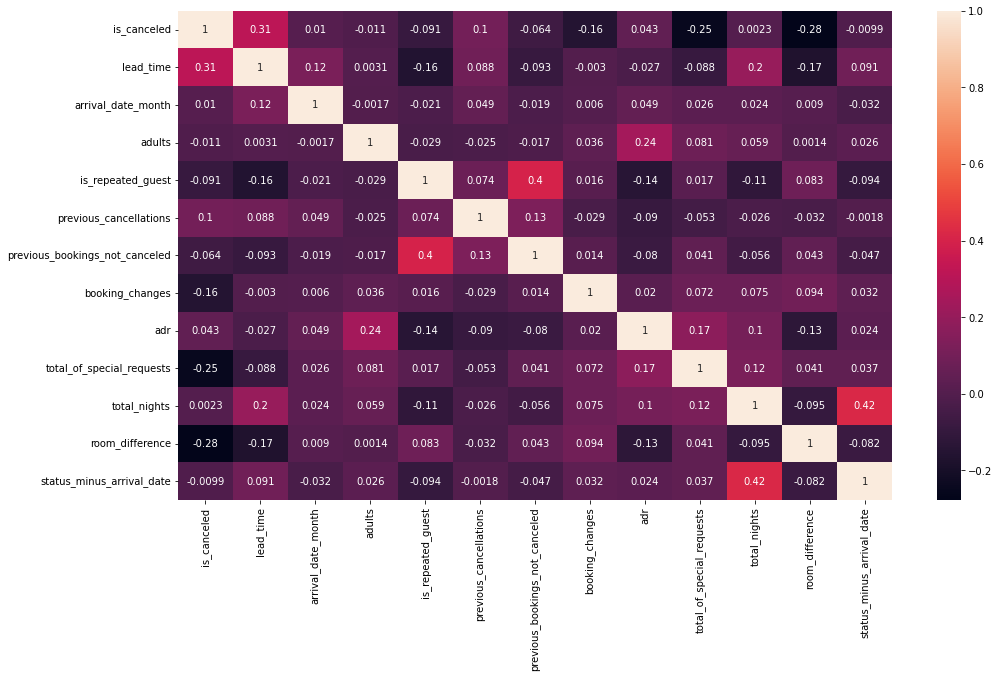

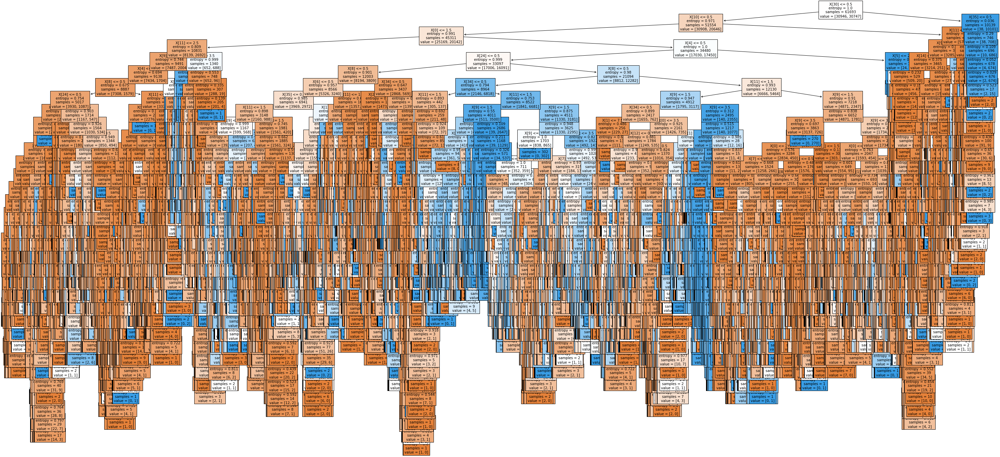

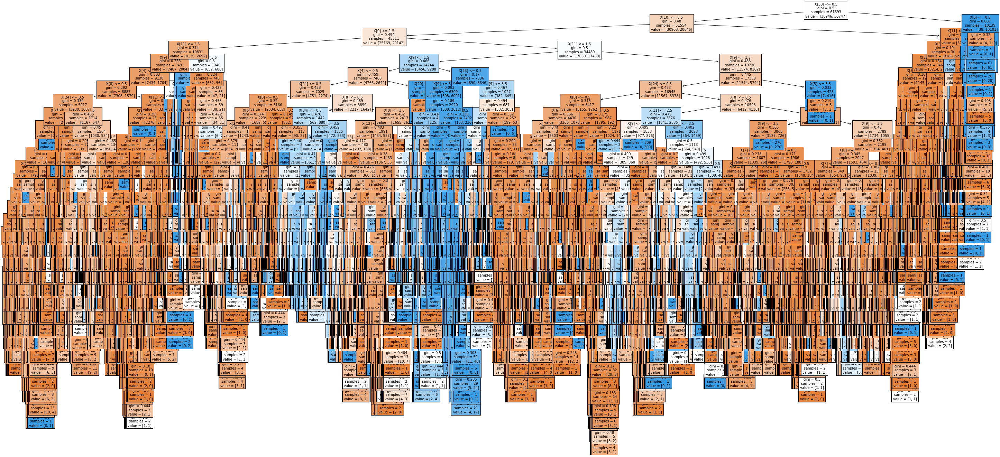

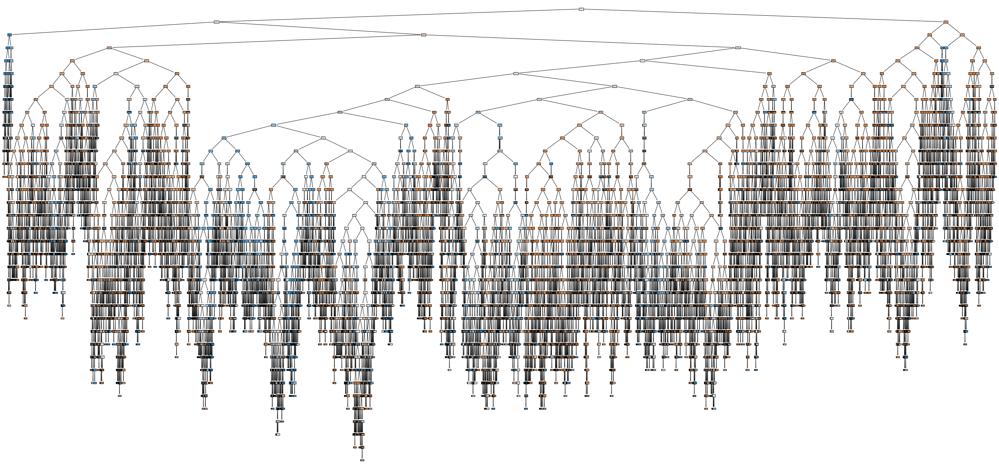

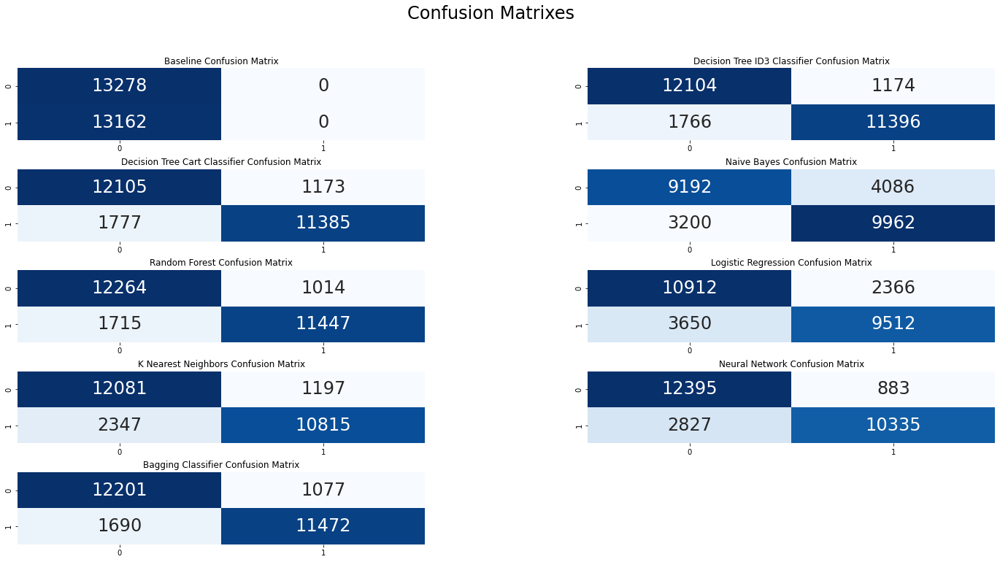

...

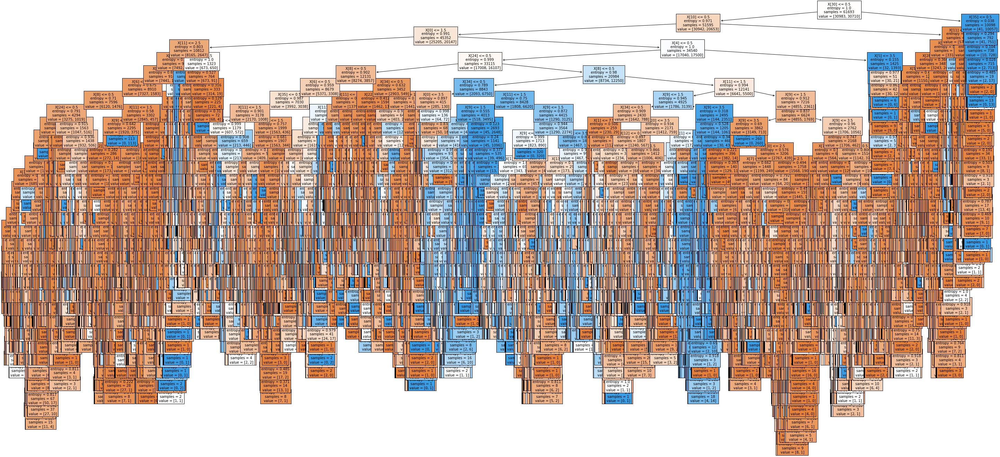

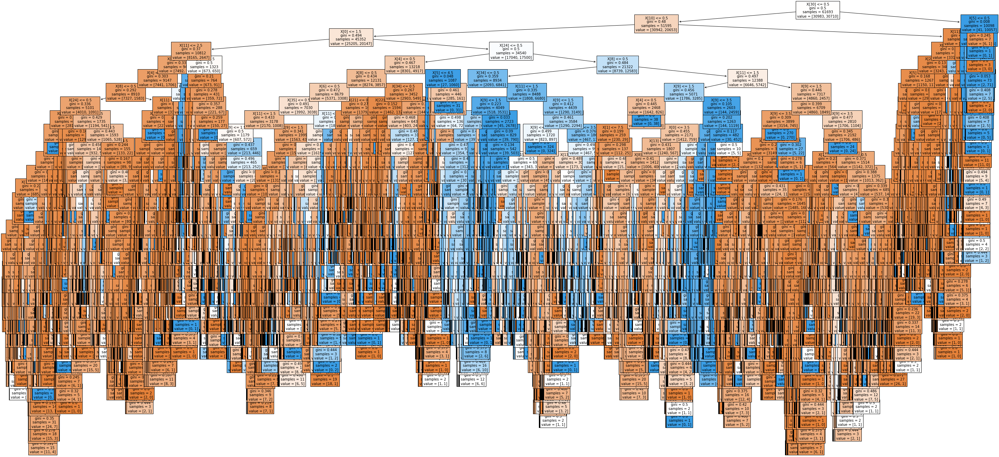

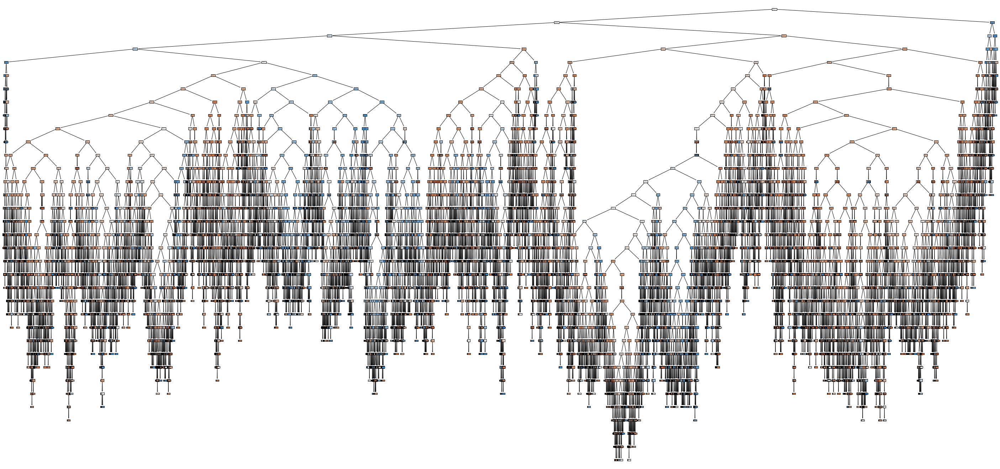

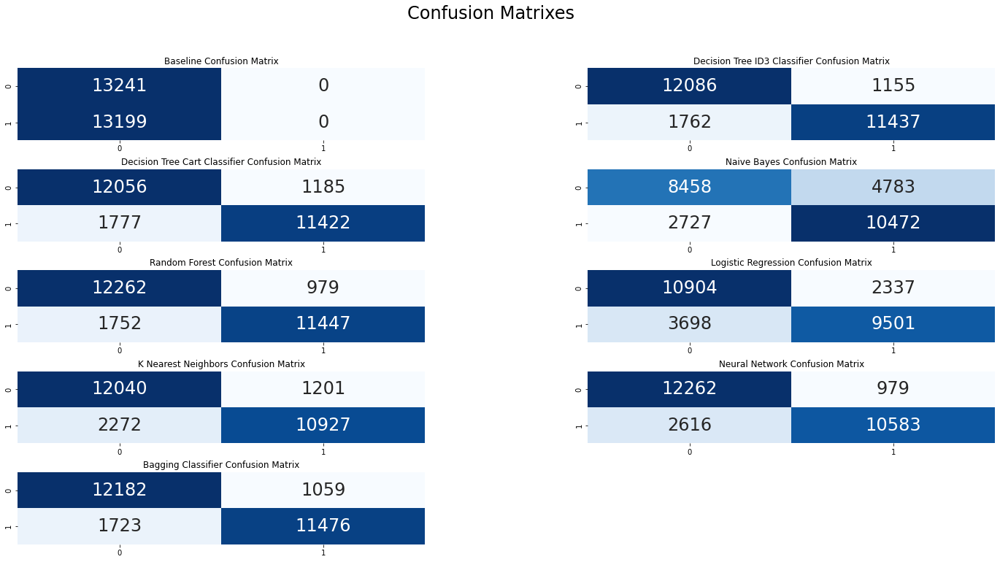

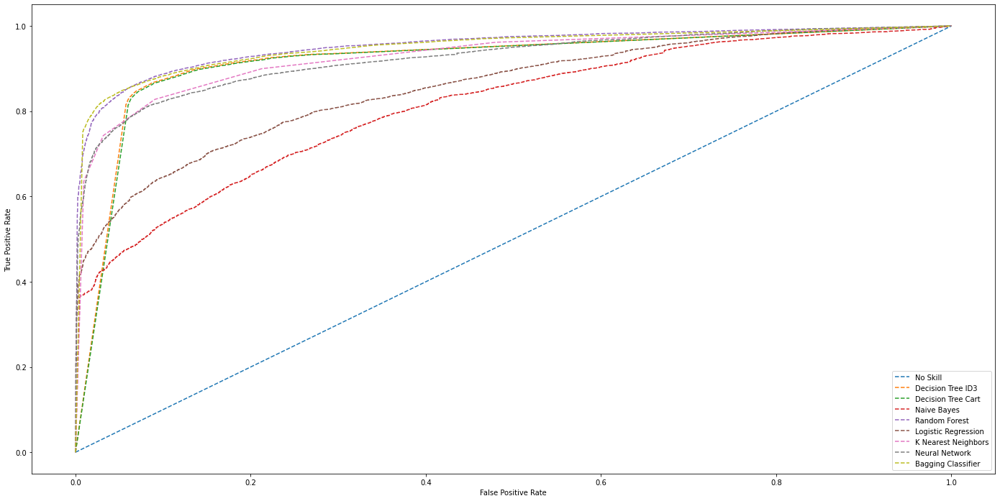

In [21]:
  df1 = df.copy()
  corr_features = correlation(df1, corr)
  print("-------------With corr equal: {0}-------------".format(corr))
  print("Length of corr_feature equal: {0}".format(len(set(corr_features)))) 
  df1 = df1.drop(corr_features, axis = 1)
  plt.figure(figsize=(16,9))
  sns.heatmap(df1.corr(method='pearson'),annot=True)
  plt.savefig('./Img/corr_heatmap_{0}.png'.format(corr))
  feature = df1.drop('is_canceled',axis=1)
  label = df1['is_canceled']
  feature_onehot = pd.get_dummies(feature,columns=feature.select_dtypes(exclude=['int64']).columns) 
  folds = ShuffleSplit(n_splits=7, random_state=42, test_size=0.3)
  feature_onehot = np.array(feature_onehot)
  label = np.array(label)
  i = 1
  for train_index, test_index  in folds.split(label):
    print("---------Time: {}---------".format(i))
    x_train, x_test = feature_onehot[train_index], feature_onehot[test_index]
    y_train, y_test = label[train_index], label[test_index]
    get_score(x_train, x_test, y_train, y_test, i, corr)
    i = i + 1


In [22]:
print("-----------------1. Baseline Model-----------------")
print("Time: {}".format(time_bm))
print("Training Acurracy: {}".format(training_score_bm))
print("Test Acurracy: {}".format(test_score_bm))

-----------------1. Baseline Model-----------------
Time: [0.0020008087158203125, 0.003814697265625, 0.0020003318786621094, 0.003000974655151367, 0.0030007362365722656, 0.0, 0.0039997100830078125]
Training Acurracy: [0.5016128247937367, 0.5001864068857083, 0.5010292901949979, 0.5026988475191675, 0.5020342664483814, 0.5033148007067252, 0.502212568686885]
Test Acurracy: [0.5021936459909229, 0.49360816944024205, 0.5035552193645991, 0.49965960665658093, 0.5012102874432678, 0.49822239031770044, 0.5007942511346445]


In [23]:
print("-----------------2. Decision Tree ID3-----------------")
print("Time: {}".format(time_id3))
print("Training Acurracy: {}".format(training_score_id3))
print("Test Acurracy: {}".format(test_score_id3))


-----------------2. Decision Tree ID3-----------------
Time: [0.28627443313598633, 0.41361021995544434, 0.3459663391113281, 0.30617308616638184, 0.2671360969543457, 0.2819981575012207, 0.3811511993408203]
Training Acurracy: [0.9480654207122364, 0.9476115604687728, 0.9475953511743633, 0.9482275136563305, 0.948600327427747, 0.9476926069408199, 0.947579141879954]
Test Acurracy: [0.8888048411497731, 0.8938350983358547, 0.8894856278366112, 0.8902798789712557, 0.8880484114977307, 0.8905068078668684, 0.8896747352496218]


In [24]:
print("-----------------3. Decision Tree Cart-----------------")
print("Time: {}".format(time_cart))
print("Training Acurracy: {}".format(training_score_cart))
print("Test Acurracy: {}".format(test_score_cart))


-----------------3. Decision Tree Cart-----------------
Time: [0.2421281337738037, 0.24202418327331543, 0.269059419631958, 0.31652212142944336, 0.455141544342041, 0.2606358528137207, 0.3557600975036621]
Training Acurracy: [0.9480654207122364, 0.9476115604687728, 0.9475953511743633, 0.9482275136563305, 0.948600327427747, 0.9476926069408199, 0.947579141879954]
Test Acurracy: [0.8884266263237519, 0.8910741301059002, 0.8880484114977307, 0.890998487140696, 0.88589258698941, 0.8901285930408472, 0.8879727685325265]


In [25]:
print("-----------------4. Naive Bayes-----------------")
print("Time: {}".format(time_nb))
print("Training Acurracy: {}".format(training_score_nb))
print("Test Acurracy: {}".format(test_score_nb))


-----------------4. Naive Bayes-----------------
Time: [0.0354924201965332, 0.03200864791870117, 0.03299546241760254, 0.025449752807617188, 0.05701422691345215, 0.031258344650268555, 0.06290769577026367]
Training Acurracy: [0.7220268101729532, 0.7228048563046051, 0.7185742304637479, 0.7207786945034282, 0.7218322986400402, 0.715802441119738, 0.7173909519718606]
Test Acurracy: [0.7244326777609682, 0.7202344931921332, 0.7225794251134644, 0.7181164901664145, 0.725, 0.713161875945537, 0.7159606656580938]


In [26]:
print("-----------------5. Random Forest-----------------")
print("Time: {}".format(time_rf))
print("Training Acurracy: {}".format(training_score_rf))
print("Test Acurracy: {}".format(test_score_rf))

-----------------5. Random Forest-----------------
Time: [5.1241326332092285, 5.098270416259766, 4.728234767913818, 4.8264079093933105, 5.577168941497803, 5.4880757331848145, 7.756305694580078]
Training Acurracy: [0.9480654207122364, 0.9475953511743633, 0.947579141879954, 0.9482113043619211, 0.948600327427747, 0.9476763976464104, 0.947579141879954]
Test Acurracy: [0.89678517397882, 0.8996974281391831, 0.8996974281391831, 0.8979198184568835, 0.8953479576399395, 0.8992813918305598, 0.8967095310136157]


In [27]:
print("-----------------6. Logistic Regression-----------------")
print("Time: {}".format(time_lr))
print("Training Acurracy: {}".format(training_score_lr))
print("Test Acurracy: {}".format(test_score_lr))


-----------------6. Logistic Regression-----------------
Time: [0.36327385902404785, 0.42143917083740234, 0.4479374885559082, 0.45038294792175293, 0.3967890739440918, 0.42317867279052734, 0.39253807067871094]
Training Acurracy: [0.7732481805067025, 0.7713030651775729, 0.7731347154458367, 0.7729077853241049, 0.7726484366135542, 0.7714489488272576, 0.7728591574408766]
Test Acurracy: [0.7724659606656581, 0.7753403933434191, 0.7719364599092284, 0.7725037821482602, 0.7699319213313162, 0.7743192133131619, 0.7717473524962178]


In [28]:
print("-----------------7. K-Nearest Neighbor-----------------")
print("Time: {}".format(time_knn))
print("Training Acurracy: {}".format(training_score_knn))
print("Test Acurracy: {}".format(test_score_knn))


-----------------7. K-Nearest Neighbor-----------------
Time: [0.0020008087158203125, 0.003000974655151367, 0.0030007362365722656, 0.0040018558502197266, 0.0, 0.0030002593994140625, 0.0]
Training Acurracy: [0.9032143030813868, 0.9007504903311558, 0.9006694438591089, 0.9023390011832785, 0.903100838020521, 0.9007180717423371, 0.9015933736404455]
Test Acurracy: [0.8659606656580938, 0.8704614220877458, 0.8679652042360061, 0.8691376701966718, 0.8665658093797277, 0.8686081694402421, 0.8686459909228442]


In [29]:
print("-----------------8. Neural Network-----------------")
print("Time: {}".format(time_nn))
print("Training Acurracy: {}".format(training_score_nn))
print("Test Acurracy: {}".format(test_score_nn))

-----------------8. Neural Network-----------------
Time: [69.80229926109314, 67.68131351470947, 61.460070848464966, 68.51539087295532, 69.99661254882812, 131.65532064437866, 64.67297434806824]
Training Acurracy: [0.8635501596615499, 0.8627559042354886, 0.8621399510479308, 0.8646361823869807, 0.8650900426304443, 0.8626910670578509, 0.8645875545037525]
Test Acurracy: [0.8596822995461422, 0.8688729198184569, 0.8638426626323752, 0.8643343419062027, 0.8632375189107413, 0.8666792738275341, 0.8640317700453858]


In [30]:
print("-----------------9. Bagging Classifier-----------------")
print("Time: {}".format(time_bc))
print("Training Acurracy: {}".format(training_score_bc))
print("Test Acurracy: {}".format(test_score_bc))


-----------------9. Bagging Classifier-----------------
Time: [2.2615926265716553, 2.1644506454467773, 1.8049657344818115, 1.8723156452178955, 2.212470054626465, 3.3979332447052, 1.7401127815246582]
Training Acurracy: [0.9446614688862593, 0.9438510041657887, 0.9441913993483864, 0.9442886551148428, 0.9449370268912194, 0.9441265621707488, 0.9441913993483864]
Test Acurracy: [0.8953479576399395, 0.8973146747352496, 0.8987518910741301, 0.8963691376701967, 0.8936459909228441, 0.896482602118003, 0.8947806354009077]


<h3>Phân tích đánh giá các thuật toán và dự báo

In [31]:
def mean(lst):
    return sum(lst) / len(lst)

<li>Đánh giá thời gian chạy của thuật toán

In [32]:
df_time = pd.DataFrame(data=[('Baseline',mean(time_bm)), ('Decision Tree ID3',mean(time_id3)), ('Decision Tree Cart',mean(time_cart)), 
                             ('Naive Bayes',mean(time_nb)), ('Random Forest',mean(time_rf)), ('Logistic Regression',mean(time_lr)), 
                             ('K-Nearest Neighbor',mean(time_knn)), ('Neural Network',mean(time_nn)), 
                             ('Bagging Classifier',mean(time_bc))],
                                       columns=['Model', 'Time'])

In [33]:
df_time

,Model,Time
0,Baseline,0.002545
1,Decision Tree ID3,0.326044
2,Decision Tree Cart,0.305896
3,Naive Bayes,0.039590
4,Random Forest,5.514085
5,Logistic Regression,0.413648
6,K-Nearest Neighbor,0.002144
7,Neural Network,76.254855
8,Bagging Classifier,2.207692


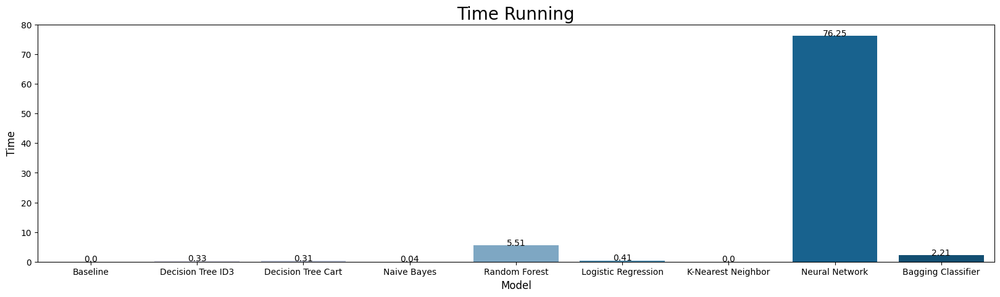

In [34]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Time', data=df_time, palette='PuBu')
plt.title('Time Running', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Time', fontsize = 12)
for index, row in df_time.iterrows():
    p.text(x=row.name, y=row.Time, s=round(row.Time,2), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Thời gian chạy của thuật toán KNN nhanh nhất khi loại bỏ mô hình Baseline. (Tương tự khi ta loại bỏ độ tương quan lớn hơn 0.7)
*   Thời gian chạy của thuật toán Neural Network chậm nhất trong tất cả các thuật toán. (Cao nhất ba lần huấn luyện)



<li>Đánh giá độ chính xác của thuật toán

<strong>Độ chính xác của tập dữ liệu đào tạo

In [35]:
df_train = pd.DataFrame(data=[('Baseline',mean(training_score_bm)), ('Decision Tree ID3',mean(training_score_id3)), ('Decision Tree Cart',mean(training_score_cart)), 
                             ('Naive Bayes',mean(training_score_nb)), ('Random Forest',mean(training_score_rf)), ('Logistic Regression',mean(training_score_lr)), 
                             ('K-Nearest Neighbor',mean(training_score_knn)), ('Neural Network',mean(training_score_nn)), 
                             ('Bagging Classifier',mean(training_score_bc))],
                                       columns=['Model', 'Accuracy'])

In [36]:
df_train

,Model,Accuracy
0,Baseline,0.501870
1,Decision Tree ID3,0.947910
2,Decision Tree Cart,0.947910
3,Naive Bayes,0.719887
4,Random Forest,0.947901
5,Logistic Regression,0.772507
6,K-Nearest Neighbor,0.901769
7,Neural Network,0.863636
8,Bagging Classifier,0.944321


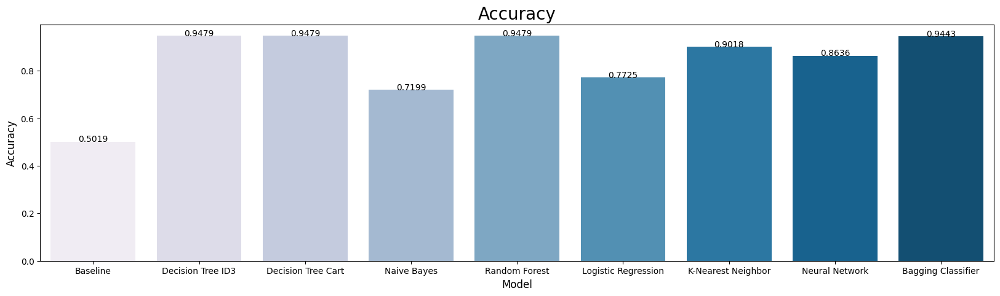

In [37]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_train, palette='PuBu')
plt.title('Accuracy', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_train.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Độ chính xác hai mô hình Decision Tree và Random Forest đồng thời cao nhất so với các mô hình còn lại.
*   Độ chính xác của Naive Bayes là thấy nhất khi loại trừ Baseline Model.



<strong>Độ hính xác của tập dữ liệu kiểm tra

In [38]:
df_test = pd.DataFrame(data=[('Baseline',mean(test_score_bm)), ('Decision Tree ID3',mean(test_score_id3)), ('Decision Tree Cart',mean(test_score_cart)), 
                             ('Naive Bayes',mean(test_score_nb)), ('Random Forest',mean(test_score_rf)), ('Logistic Regression',mean(test_score_lr)), 
                             ('K-Nearest Neighbor',mean(test_score_knn)), ('Neural Network',mean(test_score_nn)), 
                             ('Bagging Classifier',mean(test_score_bc))],
                                       columns=['Model', 'Accuracy'])

In [39]:
df_test

,Model,Accuracy
0,Baseline,0.499892
1,Decision Tree ID3,0.890091
2,Decision Tree Cart,0.888935
3,Naive Bayes,0.719927
4,Random Forest,0.897920
5,Logistic Regression,0.772606
6,K-Nearest Neighbor,0.868192
7,Neural Network,0.864383
8,Bagging Classifier,0.896099


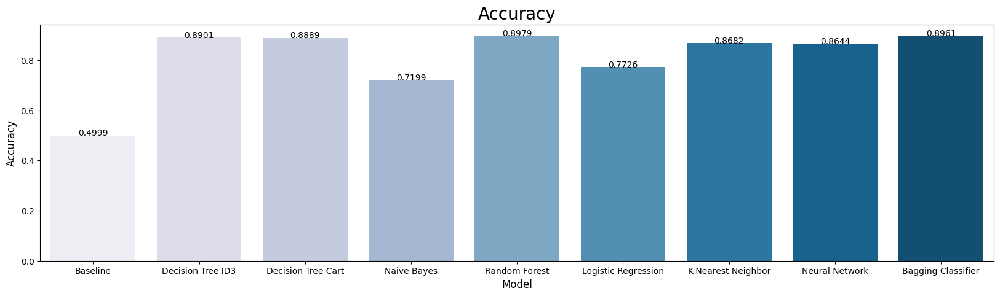

In [40]:
plt.style.use('default')
plt.figure(figsize=(20,5))
p=sns.barplot(x='Model', y='Accuracy', data=df_test, palette='PuBu')
plt.title('Accuracy', fontsize = 20)
plt.xlabel('Model', fontsize = 12)
plt.ylabel('Accuracy', fontsize = 12)
for index, row in df_test.iterrows():
    p.text(x=row.name, y=row.Accuracy, s=round(row.Accuracy,4), color='black', horizontalalignment='center');

<strong>Kết luận:</strong>


*   Độ chính xác khi tiến hành kiểm tra của Random Forest cao nhất.
*   Tương tự trong mô hình huấn luyện,mô hình Naive Bayes có độ chính xác thấp.

